In [1]:
import pandas as pd
import os
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
import warnings
warnings.filterwarnings('ignore')

In [2]:
# read in data
fin = pd.read_csv("/Users/ayushshastry/Desktop/Research/data/fin.csv")
stock = pd.read_csv("/Users/ayushshastry/Desktop/Research/data/stock.csv")

In [3]:
# Creating Stress variable
def categorize_status(status):
    if "Active" in status:
        return 0
    else:
        return 1

# Apply the function to create the LSTATUS column
fin["STRESS"] = fin["LSTATUS"].apply(categorize_status)
fin["STRESS"].value_counts()

0    1021225
1      40797
Name: STRESS, dtype: int64

In [4]:
# Rearranging columns
fin.insert(1, "COUNTRY", fin.pop("COUNTRY"))
fin.insert(2, "CURRENCY", fin.pop("CURRENCY"))
fin.insert(3, "USSIC_CORE_CODE", fin.pop("USSIC_CORE_CODE"))
fin.insert(4, "STRESS", fin.pop("STRESS"))
fin.insert(5, "LSTATUS", fin.pop("LSTATUS"))
fin.insert(6, "STATUSDATE", fin.pop("STATUSDATE"))

In [5]:
nan_count = fin.isnull().sum().sum()
print('Number of NaN values:', nan_count)

Number of NaN values: 9315935


In [6]:
fin.shape[0]

1062022

In [7]:
# getting rid of columns with all NaN values
stock.drop(columns = ['SHARE_COMMON',
                      'ASTK_DIV_SHARE',
                      'ASTK_TANG_BOOK_VALUE',
                      'ASTK_DIV_CLOSE',
                      'ASTK_DIV_HIGH',
                      'ASTK_DIV_LOW',
                      'ASTK_DIV_AVG',
                      'ASTK_DIV_PAYOUT'],
           inplace = True)
stock.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45702 entries, 0 to 45701
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  45702 non-null  object 
 1   CLOSDATE              45702 non-null  object 
 2   CLOSDATE_year         45702 non-null  int64  
 3   SD_CURRENCY           45702 non-null  object 
 4   ASTK_STOCK_SPLIT      45000 non-null  float64
 5   ASTK_PRICE_YEAR       45585 non-null  float64
 6   ASTK_PRICE_HIGH       43388 non-null  float64
 7   ASTK_PRICE_LOW        42369 non-null  float64
 8   ASTK_SHARES_OUT       44908 non-null  float64
 9   ASTK_PAR_VALUE        33585 non-null  float64
 10  ASTK_MARKET_CAP       44868 non-null  float64
 11  ASTK_EPS              44443 non-null  float64
 12  ASTK_CASHFLOWSHARE    33206 non-null  float64
 13  ASTK_SALES            42791 non-null  float64
 14  ASTK_OP_PROFIT        44327 non-null  float64
 15  ASTK_BOOK_VALUE    

In [8]:
merge = pd.merge(fin, stock, on = ['IDNR', 'CLOSDATE'], how = "inner")
merge.columns

Index(['IDNR', 'COUNTRY', 'CURRENCY', 'USSIC_CORE_CODE', 'STRESS', 'LSTATUS',
       'STATUSDATE', 'CLOSDATE', 'RSHF', 'RCEM', 'RTAS', 'CFOP', 'PRMA',
       'GRMA', 'ETMA', 'EBMA', 'NAT', 'IC', 'STOT', 'COLL', 'CRPE', 'EXOP',
       'CURR', 'LIQR', 'SHLQ', 'SOLR', 'GEAR', 'PPE', 'TPE', 'SCT', 'ACE',
       'SFPE', 'WCPE', 'TAPE', 'CLOSDATE_year', 'SD_CURRENCY',
       'ASTK_STOCK_SPLIT', 'ASTK_PRICE_YEAR', 'ASTK_PRICE_HIGH',
       'ASTK_PRICE_LOW', 'ASTK_SHARES_OUT', 'ASTK_PAR_VALUE',
       'ASTK_MARKET_CAP', 'ASTK_EPS', 'ASTK_CASHFLOWSHARE', 'ASTK_SALES',
       'ASTK_OP_PROFIT', 'ASTK_BOOK_VALUE', 'ASTK_LG_TERM_LIA',
       'ASTK_WORKING_CAP', 'ASTK_PE_RATIO_CLOSE', 'ASTK_PE_RATIO_HIGH',
       'ASTK_PE_RATIO_LOW', 'ASTK_PE_RATIO_AVG', 'ASTK_EY_CLOSE',
       'ASTK_EY_HIGH', 'ASTK_EY_LOW', 'ASTK_EY_AVG', 'ASTK_PRICE_CASH_FLOW',
       'ASTK_PBV_CLOSE', 'ASTK_PBV_HIGH', 'ASTK_PBV_LOW', 'ASTK_PBV_AVG',
       'ASTK_MARK_CAP'],
      dtype='object')

In [9]:
# Rearranging columns
merge.insert(3, "SD_CURRENCY", merge.pop('SD_CURRENCY'))
merge.insert(8, "CLOSDATE_year", merge.pop("CLOSDATE_year"))

In [10]:
merge['STRESS'].value_counts()

0    64105
1     1130
Name: STRESS, dtype: int64

In [11]:
merge.LSTATUS.value_counts()

Active                             63397
Dissolved                            731
Active (reorganization)              281
Active (insolvency proceedings)      280
In liquidation                       193
Bankruptcy                           130
Active (default of payments)          86
Active (dormant)                      60
Inactive (no precision)               55
Dissolved (bankruptcy)                14
Dissolved (merger or take-over)        7
Active (rescue plan)                   1
Name: LSTATUS, dtype: int64

In [12]:
merge = merge[(merge["LSTATUS"] != "Dissolved (merger or take-over)") & (merge["LSTATUS"] != "Inactive (no precision)")]

In [13]:
merge.LSTATUS.value_counts()

Active                             63397
Dissolved                            731
Active (reorganization)              281
Active (insolvency proceedings)      280
In liquidation                       193
Bankruptcy                           130
Active (default of payments)          86
Active (dormant)                      60
Dissolved (bankruptcy)                14
Active (rescue plan)                   1
Name: LSTATUS, dtype: int64

In [14]:
merge['STRESS'].value_counts()

0    64105
1     1068
Name: STRESS, dtype: int64

In [15]:
corr = merge.iloc[:, 10:64].corr()

for i in range(len(corr.columns)):
    for j in range(i+1, len(corr.columns)):  # Start j from i+1 to avoid redundant comparisons
        if abs(corr.iloc[i, j]) >= 0.8:
            print(f"Correlation coefficient {corr.iloc[i, j]:.2f} between {corr.columns[i]} and {corr.columns[j]}")

Correlation coefficient 0.86 between CFOP and PRMA
Correlation coefficient 0.83 between PRMA and EBMA
Correlation coefficient 0.92 between ETMA and EBMA
Correlation coefficient 0.98 between CURR and LIQR
Correlation coefficient 0.86 between SFPE and TAPE
Correlation coefficient 0.98 between ASTK_PRICE_YEAR and ASTK_PRICE_HIGH
Correlation coefficient 0.84 between ASTK_PRICE_YEAR and ASTK_PRICE_LOW
Correlation coefficient 0.95 between ASTK_PRICE_YEAR and ASTK_SALES
Correlation coefficient 0.95 between ASTK_PRICE_YEAR and ASTK_LG_TERM_LIA
Correlation coefficient 0.98 between ASTK_PRICE_YEAR and ASTK_WORKING_CAP
Correlation coefficient 0.87 between ASTK_PRICE_HIGH and ASTK_PRICE_LOW
Correlation coefficient 0.97 between ASTK_PRICE_HIGH and ASTK_SALES
Correlation coefficient 0.95 between ASTK_PRICE_HIGH and ASTK_LG_TERM_LIA
Correlation coefficient 0.97 between ASTK_PRICE_HIGH and ASTK_WORKING_CAP
Correlation coefficient -0.92 between ASTK_PRICE_LOW and ASTK_EPS
Correlation coefficient -0.86 

In [16]:
merge.drop(columns = ['ASTK_PRICE_HIGH',
                      'ASTK_PRICE_LOW',
                      'ASTK_PE_RATIO_HIGH',
                      'ASTK_PE_RATIO_LOW',
                      'ASTK_EY_HIGH',
                      'ASTK_EY_LOW',
                      'ASTK_PBV_HIGH',
                      'ASTK_PBV_LOW'],
           inplace = True)
merge.head()

,IDNR,COUNTRY,CURRENCY,SD_CURRENCY,USSIC_CORE_CODE,STRESS,LSTATUS,STATUSDATE,CLOSDATE_year,CLOSDATE,...,ASTK_LG_TERM_LIA,ASTK_WORKING_CAP,ASTK_PE_RATIO_CLOSE,ASTK_PE_RATIO_AVG,ASTK_EY_CLOSE,ASTK_EY_AVG,ASTK_PRICE_CASH_FLOW,ASTK_PBV_CLOSE,ASTK_PBV_AVG,ASTK_MARK_CAP
0,AT9010000310,AUSTRIA,EUR,EUR,671.0,0,Active,NaN,2023,2023-04-30,...,6.48,6.15,5.20,4.80,19.22,20.83,2.70,0.72,0.67,0.72
1,AT9010000310,AUSTRIA,EUR,EUR,671.0,0,Active,NaN,2023,2023-04-30,...,6.48,6.15,5.20,4.80,19.22,20.83,2.70,0.72,0.67,0.72
2,AT9010000310,AUSTRIA,EUR,EUR,671.0,0,Active,NaN,2022,2022-04-30,...,7.08,5.74,6.59,7.94,15.18,12.60,2.97,0.77,0.93,0.77
3,AT9010000310,AUSTRIA,EUR,EUR,671.0,0,Active,NaN,2022,2022-04-30,...,7.08,5.74,6.59,7.94,15.18,12.60,2.97,0.77,0.93,0.77
4,AT9010000310,AUSTRIA,EUR,EUR,671.0,0,Active,NaN,2018,2018-04-30,...,9.06,4.68,NaN,NaN,NaN,NaN,5.41,1.22,2.22,1.22


In [17]:
merge.drop(columns = ['LSTATUS', 'USSIC_CORE_CODE'], inplace = True)

In [18]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 54 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  65173 non-null  object 
 1   COUNTRY               65173 non-null  object 
 2   CURRENCY              65173 non-null  object 
 3   SD_CURRENCY           65173 non-null  object 
 4   STRESS                65173 non-null  int64  
 5   STATUSDATE            11775 non-null  object 
 6   CLOSDATE_year         65173 non-null  int64  
 7   CLOSDATE              65173 non-null  object 
 8   RSHF                  61932 non-null  float64
 9   RCEM                  47539 non-null  float64
 10  RTAS                  63202 non-null  float64
 11  CFOP                  38630 non-null  float64
 12  PRMA                  48749 non-null  float64
 13  GRMA                  36390 non-null  float64
 14  ETMA                  40963 non-null  float64
 15  EBMA               

In [19]:
corr = merge.iloc[:, 8:54].corr()

for i in range(len(corr.columns)):
    for j in range(i+1, len(corr.columns)):  # Start j from i+1 to avoid redundant comparisons
        if abs(corr.iloc[i, j]) >= 0.8:
            print(f"Correlation coefficient {corr.iloc[i, j]:.2f} between {corr.columns[i]} and {corr.columns[j]}")

Correlation coefficient 0.86 between CFOP and PRMA
Correlation coefficient 0.83 between PRMA and EBMA
Correlation coefficient 0.92 between ETMA and EBMA
Correlation coefficient 0.98 between CURR and LIQR
Correlation coefficient 0.86 between SFPE and TAPE
Correlation coefficient 0.95 between ASTK_PRICE_YEAR and ASTK_SALES
Correlation coefficient 0.95 between ASTK_PRICE_YEAR and ASTK_LG_TERM_LIA
Correlation coefficient 0.98 between ASTK_PRICE_YEAR and ASTK_WORKING_CAP
Correlation coefficient 0.99 between ASTK_EPS and ASTK_CASHFLOWSHARE
Correlation coefficient 0.88 between ASTK_EPS and ASTK_BOOK_VALUE
Correlation coefficient 0.81 between ASTK_CASHFLOWSHARE and ASTK_OP_PROFIT
Correlation coefficient 0.91 between ASTK_CASHFLOWSHARE and ASTK_BOOK_VALUE
Correlation coefficient 0.92 between ASTK_SALES and ASTK_LG_TERM_LIA
Correlation coefficient 0.92 between ASTK_SALES and ASTK_WORKING_CAP
Correlation coefficient 0.95 between ASTK_LG_TERM_LIA and ASTK_WORKING_CAP
Correlation coefficient 0.96 b

In [20]:
merge.drop(columns = ['CFOP', 'EBMA', 'LIQR', 'SFPE', 'ASTK_SALES', 'ASTK_LG_TERM_LIA', 'ASTK_WORKING_CAP', 'ASTK_CASHFLOWSHARE',
                              'ASTK_BOOK_VALUE','ASTK_OP_PROFIT', 'ASTK_PE_RATIO_CLOSE', 'ASTK_EY_CLOSE', 'ASTK_PBV_CLOSE',
                              'ASTK_MARK_CAP', 'ASTK_WORKING_CAP'], inplace = True)

In [21]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 40 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  65173 non-null  object 
 1   COUNTRY               65173 non-null  object 
 2   CURRENCY              65173 non-null  object 
 3   SD_CURRENCY           65173 non-null  object 
 4   STRESS                65173 non-null  int64  
 5   STATUSDATE            11775 non-null  object 
 6   CLOSDATE_year         65173 non-null  int64  
 7   CLOSDATE              65173 non-null  object 
 8   RSHF                  61932 non-null  float64
 9   RCEM                  47539 non-null  float64
 10  RTAS                  63202 non-null  float64
 11  PRMA                  48749 non-null  float64
 12  GRMA                  36390 non-null  float64
 13  ETMA                  40963 non-null  float64
 14  NAT                   59501 non-null  float64
 15  IC                 

In [22]:
fig = px.histogram(merge, x = "COUNTRY")
fig.show()

In [23]:
fig = px.histogram(merge, x = ["CURRENCY","SD_CURRENCY"], barmode='group').update_xaxes(categoryorder="total descending")
fig.show()

In [24]:
fig = px.box(merge, x = "TAPE", y = "STRESS", orientation='h')
fig.show()

In [25]:
fig = px.box(merge, x = "PRMA", y = "STRESS", orientation='h')
fig.show()

In [26]:
fig = px.box(merge, x = "ASTK_EPS", y = "STRESS", orientation='h')
fig.show()

In [27]:
fig = px.box(merge, x = "ASTK_EPS", y = "STRESS", orientation='h')
fig.show()

In [28]:
fig = px.box(merge, x = "TAPE", y = "STRESS", orientation='h')
fig.show()

In [29]:
fig = px.box(merge, x = "CURR", y = "STRESS", orientation='h')
fig.show()

In [30]:
fig = px.box(merge, x = "RSHF", y = "STRESS", orientation='h')
fig.show()

In [31]:
fig = px.box(merge, x = "COLL", y = "STRESS", orientation='h')
fig.show()

In [32]:
fig = px.box(merge, x = "NAT", y = "STRESS", orientation='h')
fig.show()

,STRESS,CLOSDATE_year,RSHF,RCEM,RTAS,PRMA,GRMA,ETMA,NAT,IC
count,65173.000000,65173.000000,61932.000000,47539.000000,63202.000000,48749.000000,36390.000000,40963.000000,59501.000000,44720.000000
mean,0.016387,2018.725423,-3.766237,-1.843519,-0.206065,6.753851,55.842263,9.395827,1.453530,16.364636
std,0.126960,2.553477,67.246238,51.729226,17.983580,30.233087,32.417469,28.468378,8.851405,78.363283
min,0.000000,2001.000000,-999.530000,-976.870000,-99.970000,-100.000000,-99.820000,-100.000000,0.000000,-99.930000
25%,0.000000,2017.000000,-4.522500,-2.030000,-2.740000,-1.030000,29.022500,1.820000,0.100000,-2.000000
50%,0.000000,2019.000000,4.640000,4.770000,2.360000,5.280000,53.520000,9.730000,0.650000,1.850000
75%,0.000000,2021.000000,15.300000,11.780000,7.350000,15.150000,88.310000,20.200000,1.470000,10.320000
max,1.000000,2023.000000,966.320000,904.920000,100.000000,100.000000,100.000000,99.820000,831.090000,999.240000


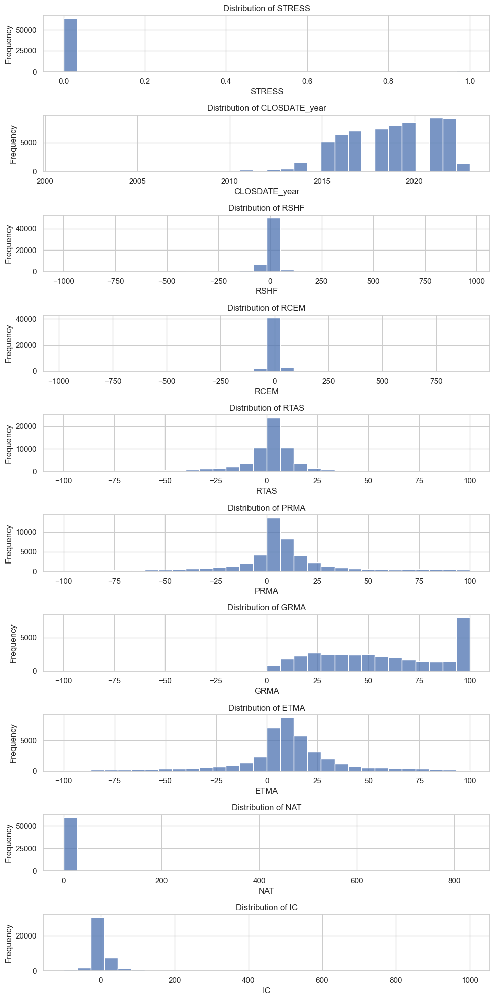

In [33]:
sns.set(style = "whitegrid")

numericals = merge.select_dtypes(include = ['float64', 'int64']).columns
numericals = numericals[0:10]

summary = merge[numericals].describe()

fig, axs = plt.subplots(len(numericals), 1, figsize = (10, 20))
fig.subplots_adjust(hspace = 0.5)

for i, col in enumerate(numericals):
  sns.histplot(merge[col], kde = False, ax = axs[i], bins = 30)
  axs[i].set_title(f'Distribution of {col}')
  axs[i].set_xlabel(col)
  axs[i].set_ylabel('Frequency')

plt.tight_layout()
summary

,STOT,COLL,CRPE,EXOP,CURR,SHLQ,SOLR,GEAR,PPE,TPE,SCT
count,37959.000000,58738.000000,56791.000000,11199.000000,62958.000000,55612.000000,64178.000000,59131.000000,4.446500e+04,5.192500e+04,40740.000000
mean,42.353614,73.955395,66.580409,29.612780,3.978486,22.391605,55.621689,70.530846,1.828443e+03,5.627052e+03,28.867472
std,112.573734,106.039886,108.998601,35.395922,8.870893,79.319238,28.707306,106.674473,2.238654e+04,7.196872e+04,21.336421
min,0.000000,0.000000,0.000000,-24.650000,0.000000,-90.640000,-99.710000,0.000000,-2.841500e+04,0.000000e+00,0.000000
25%,4.030000,16.000000,16.000000,0.000000,0.970000,1.140000,37.140000,7.240000,1.000000e+00,1.630000e+02,12.690000
50%,7.490000,49.000000,36.000000,9.510000,1.600000,2.790000,55.370000,36.240000,2.200000e+01,3.720000e+02,24.150000
75%,22.600000,85.000000,70.000000,60.825000,3.080000,9.510000,78.100000,88.785000,1.670000e+02,1.385000e+03,40.232500
max,996.530000,995.000000,999.000000,100.000000,99.990000,999.890000,100.000000,997.930000,1.820317e+06,6.816364e+06,100.000000


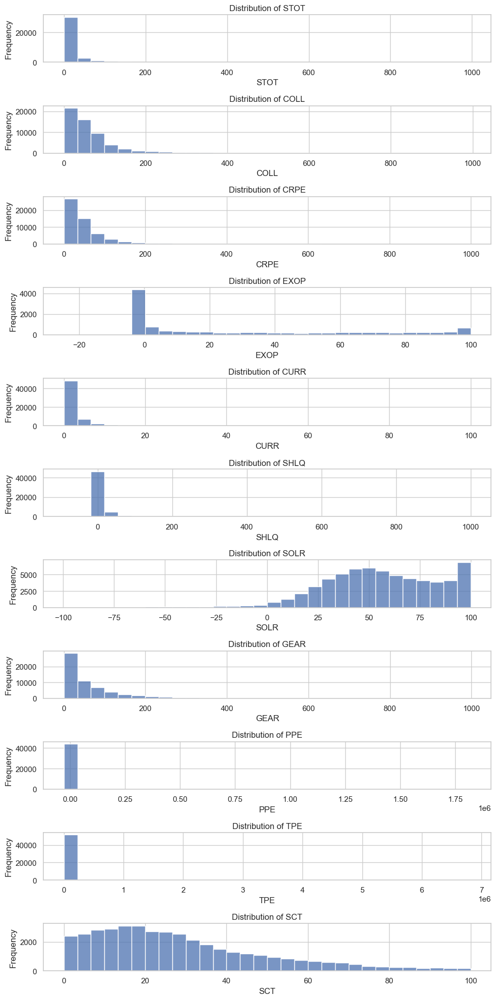

In [34]:
sns.set(style = "whitegrid")

numericals = merge.select_dtypes(include = ['float64', 'int64']).columns
numericals = numericals[10:21]

summary = merge[numericals].describe()

fig, axs = plt.subplots(len(numericals), 1, figsize = (10, 20))
fig.subplots_adjust(hspace = 0.5)

for i, col in enumerate(numericals):
  sns.histplot(merge[col], kde = False, ax = axs[i], bins = 30)
  axs[i].set_title(f'Distribution of {col}')
  axs[i].set_xlabel(col)
  axs[i].set_ylabel('Frequency')

plt.tight_layout()
summary

,SCT,ACE,WCPE,TAPE,ASTK_STOCK_SPLIT,ASTK_PRICE_YEAR,ASTK_SHARES_OUT,ASTK_PAR_VALUE,ASTK_MARKET_CAP,ASTK_EPS,ASTK_PE_RATIO_AVG
count,40740.000000,42224.000000,4.866800e+04,5.239500e+04,6.428400e+04,6.503600e+04,6.414500e+04,45635.000000,6.410200e+04,6.365400e+04,40138.000000
mean,28.867472,381.187571,1.596804e+03,3.429553e+04,1.891858e+08,1.220795e+08,1.187177e+09,124.334996,7.995473e+09,-1.456616e+07,37.217867
std,21.336421,1496.343899,3.391826e+04,3.748059e+05,1.198868e+10,1.073620e+10,4.992946e+10,3832.948241,9.966058e+10,1.430036e+09,81.035903
min,0.000000,0.000000,-1.449100e+04,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,4.500000e+02,-1.797783e+11,0.000000
25%,12.690000,46.000000,0.000000e+00,2.840000e+02,1.000000e+00,1.690000e+00,6.077922e+06,0.100000,2.616849e+07,-7.000000e-02,9.530000
50%,24.150000,71.000000,3.700000e+01,9.600000e+02,1.000000e+00,7.770000e+00,2.443887e+07,0.520000,1.460532e+08,1.400000e-01,16.740000
75%,40.232500,165.000000,1.430000e+02,5.780000e+03,1.000000e+00,3.380000e+01,1.009712e+08,1.600000,9.909026e+08,1.440000e+00,30.357500
max,100.000000,151713.000000,2.705923e+06,2.539179e+07,7.600000e+11,1.527600e+12,3.854341e+12,393507.160000,8.126643e+12,8.412414e+09,997.830000


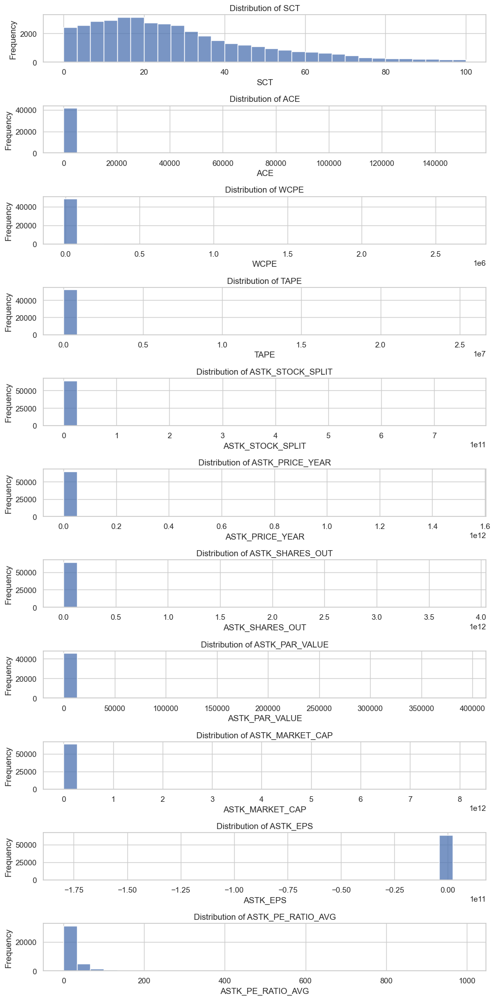

In [35]:
sns.set(style = "whitegrid")

numericals = merge.select_dtypes(include = ['float64', 'int64']).columns
numericals = numericals[20:31]

summary = merge[numericals].describe()

fig, axs = plt.subplots(len(numericals), 1, figsize = (10, 20))
fig.subplots_adjust(hspace = 0.5)

for i, col in enumerate(numericals):
  sns.histplot(merge[col], kde = False, ax = axs[i], bins = 30)
  axs[i].set_title(f'Distribution of {col}')
  axs[i].set_xlabel(col)
  axs[i].set_ylabel('Frequency')

plt.tight_layout()
summary

,ASTK_EY_AVG,ASTK_PRICE_CASH_FLOW,ASTK_PBV_AVG
count,40094.000000,48851.000000,6.152000e+04
mean,23.432871,15.254329,1.944712e+04
std,1965.561252,812.898812,3.829794e+06
min,0.000000,-38356.160000,-5.132720e+03
25%,3.280000,0.000000,8.000000e-01
50%,5.960000,6.790000,1.540000e+00
75%,10.447500,14.055000,3.260000e+00
max,393167.150000,95942.980000,9.387902e+08


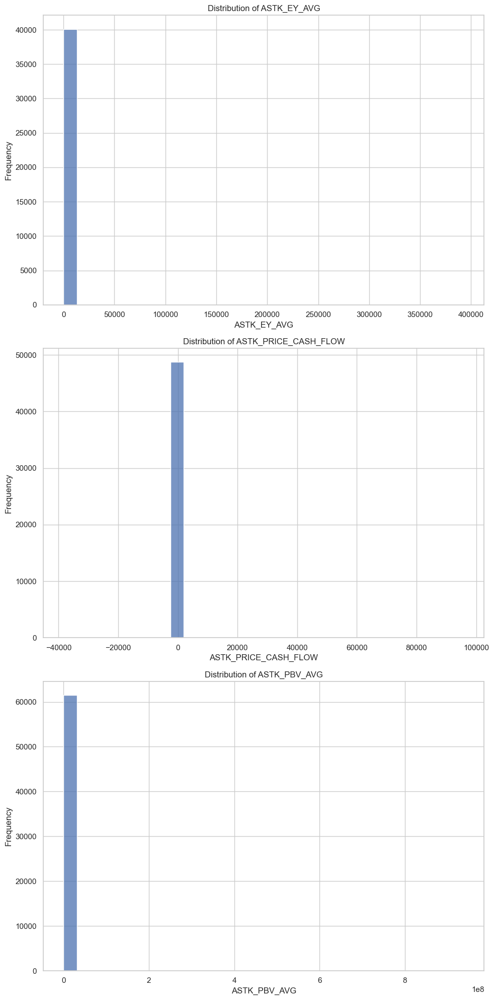

In [36]:
sns.set(style = "whitegrid")

numericals = merge.select_dtypes(include = ['float64', 'int64']).columns
numericals = numericals[31:34]

summary = merge[numericals].describe()

fig, axs = plt.subplots(len(numericals), 1, figsize = (10, 20))
fig.subplots_adjust(hspace = 0.5)

for i, col in enumerate(numericals):
  sns.histplot(merge[col], kde = False, ax = axs[i], bins = 30)
  axs[i].set_title(f'Distribution of {col}')
  axs[i].set_xlabel(col)
  axs[i].set_ylabel('Frequency')

plt.tight_layout()
summary

In [37]:
import pandas.core.algorithms as algos
import scipy.stats.stats as stats
import re
import traceback
import string

In [38]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 40 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  65173 non-null  object 
 1   COUNTRY               65173 non-null  object 
 2   CURRENCY              65173 non-null  object 
 3   SD_CURRENCY           65173 non-null  object 
 4   STRESS                65173 non-null  int64  
 5   STATUSDATE            11775 non-null  object 
 6   CLOSDATE_year         65173 non-null  int64  
 7   CLOSDATE              65173 non-null  object 
 8   RSHF                  61932 non-null  float64
 9   RCEM                  47539 non-null  float64
 10  RTAS                  63202 non-null  float64
 11  PRMA                  48749 non-null  float64
 12  GRMA                  36390 non-null  float64
 13  ETMA                  40963 non-null  float64
 14  NAT                   59501 non-null  float64
 15  IC                 

In [39]:
pop = merge.pop("STRESS")
merge.insert(6, "STRESS", pop)

In [40]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 40 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  65173 non-null  object 
 1   COUNTRY               65173 non-null  object 
 2   CURRENCY              65173 non-null  object 
 3   SD_CURRENCY           65173 non-null  object 
 4   STATUSDATE            11775 non-null  object 
 5   CLOSDATE_year         65173 non-null  int64  
 6   STRESS                65173 non-null  int64  
 7   CLOSDATE              65173 non-null  object 
 8   RSHF                  61932 non-null  float64
 9   RCEM                  47539 non-null  float64
 10  RTAS                  63202 non-null  float64
 11  PRMA                  48749 non-null  float64
 12  GRMA                  36390 non-null  float64
 13  ETMA                  40963 non-null  float64
 14  NAT                   59501 non-null  float64
 15  IC                 

In [41]:
pop = merge.pop("CLOSDATE")

In [42]:
merge_numerical = merge.iloc[:, 5:40]
merge_numerical.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 34 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   CLOSDATE_year         65173 non-null  int64  
 1   STRESS                65173 non-null  int64  
 2   RSHF                  61932 non-null  float64
 3   RCEM                  47539 non-null  float64
 4   RTAS                  63202 non-null  float64
 5   PRMA                  48749 non-null  float64
 6   GRMA                  36390 non-null  float64
 7   ETMA                  40963 non-null  float64
 8   NAT                   59501 non-null  float64
 9   IC                    44720 non-null  float64
 10  STOT                  37959 non-null  float64
 11  COLL                  58738 non-null  float64
 12  CRPE                  56791 non-null  float64
 13  EXOP                  11199 non-null  float64
 14  CURR                  62958 non-null  float64
 15  SHLQ               

In [43]:
#imputate null values with mean values

merge_numerical = merge_numerical.fillna(merge_numerical.mean())

In [44]:
count = merge_numerical["STRESS"].count()
count

65173

In [45]:
categories = {'Liquidity Ratios':["CURR", "SHLQ"],
              'Profatibility Ratios':["RSHF","RCEM","RTAS", "PRMA", "GRMA", "ETMA"],
              'Leverage Ratios': ["SOLR","GEAR"],
              'Efficiency Ratios': ["NAT", "IC", "STOT", "COLL", "CRPE"],
              'Market Ratios': ['ASTK_PE_RATIO_AVG','ASTK_PRICE_CASH_FLOW', 'ASTK_EPS','ASTK_PBV_AVG', 'ASTK_STOCK_SPLIT', 'ASTK_PRICE_YEAR',
                                'ASTK_MARKET_CAP', 'ASTK_PAR_VALUE', 'ASTK_EY_AVG', 'ASTK_SHARES_OUT']}

In [46]:
def information(df, predictor, response):
  # create copy of merge_numerical
  copy = df.copy()

  # create bins for each predictor
  copy['bin'] = pd.qcut(copy[predictor], q = 10, duplicates = 'drop')
  # copy['bin'] = pd.cut(copy[predictor], bins = 10)

  # get count of all stress records and save that in variable total
  total = copy["STRESS"].count()

  # get count of all non-defaulted companies and save that in total_good variable
  total_good = len(df[df['STRESS'] == 0])

  # get count of all defaulted companies and save that in total_bad variable
  total_bad = len(df[df["STRESS"] == 1])

  if total_good == 0 or total_bad == 0:
    return None, None

  # compute ratio of good for each predictor saved in good variable

  # per bin this is creating a sum and count variable for stress
  # since non-default banks are labeled as 0, the sum function will only sum up the 1s (defaulted banks ‼️) showing us
  # how many defaulted banks there are in each bin
  grouped = copy.groupby('bin').agg({response: ['sum', 'count']})

  # renaming these columns to be named good and bad
  grouped.columns = ['bad', 'total']

  # creating a new column named good derived by total - bad
  grouped['good'] = grouped['total'] - grouped['bad']



  # compute the IV and WOE
  grouped['good_dist'] = grouped['good'] / total_good
  grouped['bad_dist'] = grouped['bad'] / total_bad
  grouped['WOE'] = np.log(grouped['good_dist'] / grouped['bad_dist'])
  grouped['IV'] = (grouped['good_dist'] - grouped['bad_dist']) * grouped['WOE']

  iv = grouped['IV'].sum()
  # return IV and WOE

  return grouped[['WOE', 'IV']], iv
  # outside function iterate through all the predictors and then call iv() to get IV and WOE for all predictors




# display results
for category, predictor_list in categories.items():
  print(f"Category: {category}\n")
  for predictor in predictor_list:
    print(f"Predictor: {predictor}")
    woe_iv, iv_value = information(merge_numerical, predictor, 'STRESS')
    if woe_iv is not None:
      result = {'WOE': woe_iv, 'IV': iv_value}
      # print(f"Bin Results: {result}\n")
      print(f"Information Value (IV): {result['IV']}\n")

# USING pd.cut() does create 10 bins however a lot of them are Nan or Inf
# USING pd.qcut() does not create 10 bins for every predictor due to the nature of that predictor.
# However, NaN and inf values do not exist when using qcut



Category: Liquidity Ratios

Predictor: CURR
Information Value (IV): 1.4086541862995423

Predictor: SHLQ
Information Value (IV): 1.473058167248339

Category: Profatibility Ratios

Predictor: RSHF
Information Value (IV): 0.6285637600526257

Predictor: RCEM
Information Value (IV): 0.29925825827919506

Predictor: RTAS
Information Value (IV): 0.23164565071032361

Predictor: PRMA
Information Value (IV): 1.4712225748982937

Predictor: GRMA
Information Value (IV): 0.5180513954751235

Predictor: ETMA
Information Value (IV): 1.2303131640340967

Category: Leverage Ratios

Predictor: SOLR
Information Value (IV): 1.6878632054281528

Predictor: GEAR
Information Value (IV): 1.8989501142641194

Category: Efficiency Ratios

Predictor: NAT
Information Value (IV): 1.119589253347827

Predictor: IC
Information Value (IV): 1.03904902613466

Predictor: STOT
Information Value (IV): 0.5960534331998408

Predictor: COLL
Information Value (IV): 1.6520747291668683

Predictor: CRPE
Information Value (IV): 1.3406656

In [47]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import FixedThresholdClassifier
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.feature_selection import RFECV
import sklearn.inspection as inspectiion
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay, mean_squared_error, f1_score
from sklearn.feature_selection import SelectFromModel
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SMOTE

In [48]:
merge.head()

,IDNR,COUNTRY,CURRENCY,SD_CURRENCY,STATUSDATE,CLOSDATE_year,STRESS,RSHF,RCEM,RTAS,...,ASTK_STOCK_SPLIT,ASTK_PRICE_YEAR,ASTK_SHARES_OUT,ASTK_PAR_VALUE,ASTK_MARKET_CAP,ASTK_EPS,ASTK_PE_RATIO_AVG,ASTK_EY_AVG,ASTK_PRICE_CASH_FLOW,ASTK_PBV_AVG
0,AT9010000310,AUSTRIA,EUR,EUR,NaN,2023,0,15.38,10.30,6.59,...,1.0,7.12,43500000.0,NaN,309719995.0,1.37,4.80,20.83,2.70,0.67
1,AT9010000310,AUSTRIA,EUR,EUR,NaN,2023,0,5.52,5.36,5.05,...,1.0,7.12,43500000.0,NaN,309719995.0,1.37,4.80,20.83,2.70,0.67
2,AT9010000310,AUSTRIA,EUR,EUR,NaN,2022,0,12.21,7.99,4.73,...,1.0,6.90,43500000.0,NaN,300150004.0,1.05,7.94,12.60,2.97,0.93
3,AT9010000310,AUSTRIA,EUR,EUR,NaN,2022,0,17.21,15.66,15.27,...,1.0,6.90,43500000.0,NaN,300150004.0,1.05,7.94,12.60,2.97,0.93
4,AT9010000310,AUSTRIA,EUR,EUR,NaN,2018,0,-8.82,-2.15,-2.40,...,1.0,7.50,43500000.0,NaN,326250000.0,-1.07,NaN,NaN,5.41,2.22


In [49]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 39 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   IDNR                  65173 non-null  object 
 1   COUNTRY               65173 non-null  object 
 2   CURRENCY              65173 non-null  object 
 3   SD_CURRENCY           65173 non-null  object 
 4   STATUSDATE            11775 non-null  object 
 5   CLOSDATE_year         65173 non-null  int64  
 6   STRESS                65173 non-null  int64  
 7   RSHF                  61932 non-null  float64
 8   RCEM                  47539 non-null  float64
 9   RTAS                  63202 non-null  float64
 10  PRMA                  48749 non-null  float64
 11  GRMA                  36390 non-null  float64
 12  ETMA                  40963 non-null  float64
 13  NAT                   59501 non-null  float64
 14  IC                    44720 non-null  float64
 15  STOT               

In [50]:
merge = merge[['ASTK_PBV_AVG', 'GEAR', 'SOLR', "COLL", "SHLQ", "PRMA", "CURR", "ASTK_MARKET_CAP", "CRPE", "ASTK_EY_AVG", "COUNTRY", "STRESS"]]

In [51]:
merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65173 entries, 0 to 65234
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ASTK_PBV_AVG     61520 non-null  float64
 1   GEAR             59131 non-null  float64
 2   SOLR             64178 non-null  float64
 3   COLL             58738 non-null  float64
 4   SHLQ             55612 non-null  float64
 5   PRMA             48749 non-null  float64
 6   CURR             62958 non-null  float64
 7   ASTK_MARKET_CAP  64102 non-null  float64
 8   CRPE             56791 non-null  float64
 9   ASTK_EY_AVG      40094 non-null  float64
 10  COUNTRY          65173 non-null  object 
 11  STRESS           65173 non-null  int64  
dtypes: float64(10), int64(1), object(1)
memory usage: 6.5+ MB


In [52]:
categorical = merge.select_dtypes(include = ['object'])

In [53]:
for column in categorical.columns:
  mode_value = categorical[column].mode()[0]
  merge[column].fillna(mode_value, inplace=True)

In [54]:

merge.isnull().sum().head(40)

ASTK_PBV_AVG        3653
GEAR                6042
SOLR                 995
COLL                6435
SHLQ                9561
PRMA               16424
CURR                2215
ASTK_MARKET_CAP     1071
CRPE                8382
ASTK_EY_AVG        25079
COUNTRY                0
STRESS                 0
dtype: int64

In [55]:
numerical = merge.select_dtypes(include = ['int64', 'float64'])
bankrupt = merge['STRESS']
numerical = numerical.drop(columns = ['STRESS'])

In [56]:
for column in numerical.columns:
  mean_value = numerical[column].mode()[0]
  merge[column].fillna(mean_value, inplace=True)

In [57]:
merge.isnull().sum().head(40)

ASTK_PBV_AVG       0
GEAR               0
SOLR               0
COLL               0
SHLQ               0
PRMA               0
CURR               0
ASTK_MARKET_CAP    0
CRPE               0
ASTK_EY_AVG        0
COUNTRY            0
STRESS             0
dtype: int64

In [58]:
df = pd.get_dummies(merge)
X = df.drop(columns = ['STRESS'], axis = 1)
y = df['STRESS']
features = X.columns

In [59]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [60]:
log_reg = LogisticRegression(random_state=0).fit(X, y)

In [61]:
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

In [62]:
X_train.shape, X_test.shape

((52138, 50), (13035, 50))

In [63]:
rf = RandomForestClassifier(random_state=42)

In [64]:
# Train the model on the resampled data
log_reg.fit(X_resampled, y_resampled)

LogisticRegression(random_state=0)

In [65]:
y_pred = log_reg.predict(X_test)

In [67]:
print(y_pred)

[0 0 0 ... 0 0 1]


In [68]:
score = log_reg.score(X_test, y_test)
print("Accuracy:", score)

Accuracy: 0.735174530111239


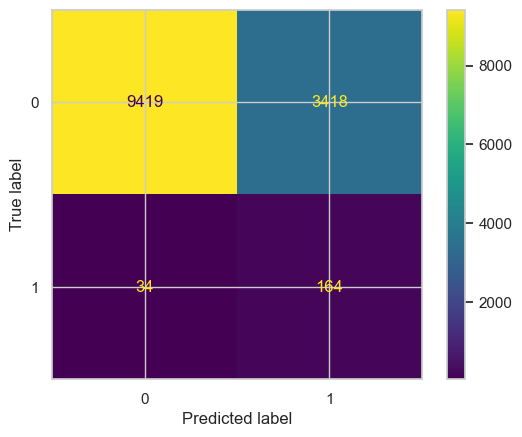

In [69]:
_ = ConfusionMatrixDisplay.from_estimator(log_reg, X_test, y_test)

In [70]:
second_log_reg = FixedThresholdClassifier(log_reg, threshold = 0.7)
second_log_reg.fit(X_resampled, y_resampled)

FixedThresholdClassifier(estimator=LogisticRegression(random_state=0),
                         threshold=0.7)

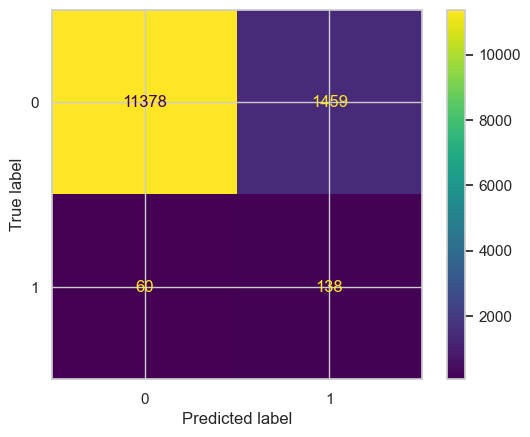

In [71]:
_ = ConfusionMatrixDisplay.from_estimator(second_log_reg, X_test, y_test)

In [72]:
score = second_log_reg.score(X_test, y_test)
print("Accuracy:", score)

Accuracy: 0.8834675872650556
